In [ ]:
from google.colab import drive

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

import csv
from sklearn.preprocessing import MinMaxScaler
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix, matthews_corrcoef, cohen_kappa_score

from xgboost import XGBClassifier

drive.mount('/content/drive')

# 1 Author

**Student Name**: Alex Santonastaso  
**Student ID**:  210991068



# 2 Problem formulation

This problem will consist of a binary classification task using machine learning algorithms that will learn how to assign a class label to examples from the MLEnd Hums and Whistles Dataset. More precisely the algorithm will take as input 3 features representing a Potter or StarWars audio file and predict its label.

# 3 Machine Learning pipeline

The following paragraph describes the machine learning pipeline:


### **Data loading**

**Input:** the audio data in .wav format will be retrieved from MLEnd Hums and Whistles Potter and StarWars dataset, composed of 417 Potter and 417 StarWars samples, totalling 834 files.

### **Transformation:**

***Feature extraction*** is used to transform raw data into numerical features that can be processed while preserving the information in the original data set.


***Label Encoding*** converting Potter and StarWars labels to Boolean type (True and False).

***Linear tranformation***: of the extracted feature data using MinMaxScaler.


### **Models:**

Support Vector Machine, Logistic Regression, Naive Bayes classifier, XGBoost classifier, Adaboost classifier models are implemented for the resolution of this problem.


### **Model Evaluation:**

Model validation performance evaluated using accuracy, confusion matrix MCC score and Kappa score.

# 4 Transformation stage
    
### **Feature extraction**:  

***Input: raw .wav data for Potter and Starwars (417 files for each label):***
    
The original data was in .wav format, each file consisting of hundred thousands samples. In order to reduce dimensionality features were extracted using signal processing functions obtained from the Librosa library. The following features were extracted:
    
**Spectral Features**

1. Mel-frequency cepstral coefficients (MFCCs)(librosa.feature.mfcc)
2. Spectral bandwidth (librosa.feature.spectral_bandwidth)
    
**Beat and tempo Feature**

1. Tempo Estimation (librosa.beat.tempo)

    
***Output: The features extracted resulted in a 3-dimensional vector of features***



### **Feature scaling**:

***Input: Numerical Features:***

The features extracted were normalised using a normalisation technique MinMaxScaler [0,1]. The reason for this scaling is because the data isn't normally distributed. This approach was used to preserve the shape of the data.

***Output: 3 Dimensional Normalised Feature Array***



### **Label Encoding**:

***Input: Categorical Data:***

***Output***: Potter and StarWars are respectively converted to Boolean values (True and False).

# 5 Modelling

The following Machine Learning models were implemented:
1.  Support Vector Machine (SVM).
2.  Logistic Regression.
3.  Gaussian Naive Bayes.
4.  XGBoost Classifier.
5.  AdaBoost Classifier.

# 6 Methodology

**Data Split:** : The data is split into training data consisting of 70% of instances and validation data consisting of 30% of instances.

**Predictors and Labels**: An array of normalized features were used as predictors and 'Potter'(True), 'StarWars'(StarWars) were used as y labels.

**Model Training:** The models were trained on the training data consisting of 70% of the dataset. A Support Vector Machine (SVM) classification algorithm, Logistic Regression classification, Gaussian Naive Bayes, XGBoost classifier, AdaBoost classifier were trained.

**Model Peformance:** After each model was fitted to the 70% training data split, it was validated on the remaining 30% to assess performance. Each models performance was compared using accuracy, confusion matrix, MCC score, Kappa score.


# 7 Dataset

The dataset used for this problem is a subset of the MLEnd Hums and Whistles dataset consisting of only hum and whistles of Potter and StarWars songs.
\
First, let's define a function that will allow us to download a file into a chosen location.

In [ ]:
def download_url(url, save_path):
    with urllib.request.urlopen(url) as dl_file:
        with open(save_path, 'wb') as out_file:
            out_file.write(dl_file.read())

The next step is to download the files 'Potter_1.zip', 'Potter_2.zip', 'StarWars_1.zip', 'StarWars_2.zip' into the already existing folder MyDrive/Data/MLEndHW in my Google Drive.

In [ ]:
#Potter1
url  = "https://collect.qmul.ac.uk/down?t=6P0I5CAE7JPPKNDU/4P729FD6DFNO8IT4NNFR458"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Potter1.zip'
download_url(url, save_path)

In [ ]:
#Potter2
url  = "https://collect.qmul.ac.uk/down?t=452THMOKUOST11V4/4L7IBFL5AJ3AMR45JVV9AC0"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Potter2.zip'
download_url(url, save_path)

In [ ]:
#StarWars1
url  = "https://collect.qmul.ac.uk/down?t=4HOGB7IH67J8QGL3/5D5TJMIP30DFVC69AQU5ETO"
save_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars1.zip'
download_url(url, save_path)

In [ ]:
#StarWars2
url  = "https://collect.qmul.ac.uk/down?t=4LUHB7IH67J8QGL3/6T5IF3SK8KQTL7FRD2113DO"
save_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars2.zip'
download_url(url, save_path)

After downloading is complete we can run the following cell to check that the MLEndHW contains the files 'Potter1.zip', 'Potter2.zip', 'StarWars1.zip', 'StarWars2.zip'.

In [ ]:
path = '/content/drive/MyDrive/Data/MLEndHW'
os.listdir(path)

['Potter',
 'StarWars',
 'Potter1.zip',
 'Potter2.zip',
 'StarWars1.zip',
 'StarWars2.zip']

Let's unzip the data we just downloaded: Potter Hums and Whistles into the 'Potter' folder; StarWars Hums and Whistles into the 'StarWars' folder. Then we can check how many files we have.

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Potter/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Potter1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Potter/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Potter2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/StarWars/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/StarWars/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
potterPath = '/content/drive/MyDrive/Data/MLEndHW/Potter/*'
potterFiles = glob.glob(potterPath)
print('There are ' + str(len(potterFiles)) + ' Potter samples.')

starWarsPath = '/content/drive/MyDrive/Data/MLEndHW/StarWars/*'
starWarsFiles = glob.glob(starWarsPath)
print('There are ' + str(len(starWarsFiles)) + ' StarWars samples.')

files = potterFiles+starWarsFiles
print('There are ' + str(len(files)) + ' total samples.')

There are 417 Potter samples.
There are 417 StarWars samples.
There are 834 total samples.


Let's listen to some random audio files:

In [ ]:
for _ in range(5):
  n = np.random.randint(834)
  display(ipd.Audio(files[n]))

Let's have a look at the name of the 834 audio file:

In [ ]:
for file in files:
  print(file.split('/')[-1])

S202_hum_2_Potter.wav
S193_whistle_2_Potter.wav
S129_whistle_2_Potter.wav
S129_hum_2_Potter.wav
S202_hum_1_Potter.wav
S121_hum_1_Potter.wav
S193_hum_2_Potter.wav
S121_hum_2_Potter.wav
S119_hum_2_Potter.wav
S140_whistle_2_Potter.wav
S133_whistle_2_Potter.wav
S40_hum_2_potter.wav
S207_hum_2_Potter.wav
S119_hum_1_Potter.wav
S207_whistle_2_Potter.wav
S140_hum_2_Potter.wav
S133_hum_2_Potter.wav
S103_hum_2_Potter.wav
S191_hum_2_Potter.wav
S181_hum_1_potter.wav
S40_whistle_2_potter.wav
S103_whistle_2_Potter.wav
S191_hum_1_Potter.wav
S181_hum_2_potter.wav
S17_hum_1_Potter.wav
S115_hum_2_Potter.wav
S196_hum_2_Potter.wav
S115_whistle_2_Potter.wav
S196_hum_1_Potter.wav
S17_hum_2_Potter.wav
S168_whistle_2_Potter.wav
S16_whistle_2_Potter.wav
S16_hum_2_Potter.wav
S206_hum_2_Potter.wav
S206_hum_1_Potter.wav
S168_hum_2_Potter.wav
S163_whistle_2_Potter.wav
S163_hum_2_Potter.wav
S125_hum_2_Potter.wav
S23_hum_1_Potter.wav
S23_hum_2_Potter.wav
S70_hum_1_Potter.wav
S70_hum_2_Potter.wav
S172_whistle_2_Potte

As we can see, the name of each file follows the naming convention [Participant ID][type of recording][interpretation number][song]. However we can notice just by skimming through the file list that some naming inconsistencies are present: for example 'harry potter' or '[Potter]' in the 'song' field, instead of 'Potter'. We can parse each file name and extract this information. Let's do it for the first one:




In [ ]:
print('The full path to the first audio file is: ', files[0])
print('\n')
print('The name of the first audio file is: ', files[0].split('/')[-1])
print('    The participand ID is: ', files[0].split('/')[-1].split('_')[0])
print('    The type of interpretation is: ', files[0].split('/')[-1].split('_')[1])
print('    The interpretation number is: ', files[0].split('/')[-1].split('_')[2])
print('    The song is: ', files[0].split('/')[-1].split('_')[3])

The full path to the first audio file is:  /content/drive/MyDrive/Data/MLEndHW/Potter/S202_hum_2_Potter.wav


The name of the first audio file is:  S202_hum_2_Potter.wav
    The participand ID is:  S202
    The type of interpretation is:  hum
    The interpretation number is:  2
    The song is:  Potter.wav


As what we care for this classification problem is only the file label (Potter or StarWars), we will run this two regex function that will return two lists containing all the inconsistent Potter and StarWars file names.

In [ ]:
inconsistentPotterFiles = []
print(f' The following inconsitent file names have been indentifed:\n')
for file in potterFiles:
    match = re.search("_Potter.wav", file)
    if match:
        pass
    else:
         inconsistentPotterFiles.append(file.split('Potter/',1)[1:])
         print(file.split('Potter/',1)[1:])
len(inconsistentPotterFiles)

 The following inconsitent file names have been indentifed:

['S40_hum_2_potter.wav']
['S181_hum_1_potter.wav']
['S40_whistle_2_potter.wav']
['S181_hum_2_potter.wav']
['S131_whistle_1_[Potter].wav']
['S38_hum_3_Potterwav.wav']
['S131_hum_1_[Potter].wav']
['S211_hum_1_Potter.Wav']
['S211_hum_2_Potter.Wav']
['S82_hum_4_[Potter].wav']
['S82_hum_1_[Potter].wav']
['S194_hum_1_[Potter].wav']
['S114_hum_1_potter.wav']
['S114_hum_2_potter.wav']
['S35_hum_1_[Potter].wav']
['S194_Whistle_1_[Potter].wav']
['S35_hum_4_[Potter].wav']
['S109_whistle_1_[Potter].wav']
['S109_hum_1_[Potter].wav']
['S96_whistle_1_[Potter].wav']
['S96_hum_1_[Potter].wav']
['S189_whistle_2_potter.wav']
['S189_hum_2_potter.wav']
['S79_hum_4_[Potter].wav']
['S79_hum_1_[Potter].wav']
['S61_whistle_1_[Potter].wav']
['S61_hum_1_[Potter].wav']
['S186_hum_1_[Potter].wav']
['S186_hum_4_[Potter].wav']
['S145_whistle_1_[Potter].wav']
['S145_hum_1_[Potter].wav']
['S164_hum_1_[Potter].wav']
['S164_whistle_1_[Potter].wav']
['S88_hum_1

71

In [ ]:
inconsistentStarWarsFiles = []
print(f' The following inconsitent StarWars file names have been indentifed:\n')
for file in starWarsFiles:
    match = re.search("_StarWars.wav", file)
    if match:
        pass
    else:
         inconsistentStarWarsFiles.append(file.split('StarWars/',1)[1:])
         print(file.split('StarWars/',1)[1:])
len(inconsistentStarWarsFiles)

 The following inconsitent StarWars file names have been indentifed:

['S88_hum_2_[StarWars].wav']
['S88_hum_1_[StarWars].wav']
['S63_hum_3_[Starwars].wav']
['S63_hum_4_[Starwars].wav']
['S164_hum_1_[StarWars].wav']
['S164_hum_2_[StarWars].wav']
['S202_hum_3_Starwars.wav']
['S202_hum_4_Starwars.wav']
['S99_hum_1_[StarWars].wav']
['S99_hum_2_[StarWars].wav']
['S106_hum_3_Starwars.WAV']
['S106_hum_4_Starwars.WAV']
['S37_hum_2_[StarWars].wav']
['S107_hum_2_Starwars.wav']
['S47_hum_4_starwars.wav']
['S47_hum_3_starwars.wav']
['S37_hum_1_[StarWars].wav']
['S107_whistle_2_Starwars.wav']
['S8_hum_3_[StarWars].wav']
['S8_hum_4_[StarWars].wav']
['S61_hum_2_[StatWars].wav']
['S61_hum_1_[StarWars].wav']
['S109_hum_3_[StarWars].wav']
['S109_hum_4_[StarWars].wav']
['S95_Whistle 1 StarWars.wav']
['S123_whistle_2_Starwars.wav']
['S123_hum_2_Starwars.wav']
['S95_Hum 1 StarWars.wav']
['S76_whistle_2_Starwars.wav']
['S221_hum_1_StartWars.wav']
['S157_hum_3_Starwars.wav']
['S157_hum_4_Starwars.wav']
['S1

94

In [ ]:
inconsistentFiles = inconsistentPotterFiles + inconsistentStarWarsFiles
print('There are ' + str(len(inconsistentFiles)) + ' total samples with inconsistent naming convention.')
print('There are ' + str(len(inconsistentPotterFiles)) + ' Potter samples with inconsistent naming convention.')
print('There are ' + str(len(inconsistentStarWarsFiles)) + ' StarWars samples with inconsistent naming convention.')

There are 165 total samples with inconsistent naming convention.
There are 71 Potter samples with inconsistent naming convention.
There are 94 StarWars samples with inconsistent naming convention.


We can create a table-like structure using Python lists that collects the information that we can extract from the names of the audio files.
\
In order to avoid errors caused by the files with inconsistent naming convention, we will enter the song name manually: 'Potter' for all the files contained in the potterFiles list, 'StarWars' for all the files contained in the starWarsFiles list.
\
For each of these two filelist, we will check with regex function 'search' if the words 'hum' or 'Hum' is contained in every file. If it is, the interpretation type 'Hum' will be added to the file in the list, otherwise 'Whistle' will be appended to the file.

In [ ]:
MLENDHW_table = []

for file in potterFiles:
  match1 = re.search("hum", file)
  match3 = re.search("Hum", file)
  fileName = file.split('/')[-1]
  interpreterID = ((file.split('/')[7]).split('_')[0])
  song = 'Potter'
  if match1 or match3:
    MLENDHW_table.append([fileName,interpreterID,'Hum', song])
  else:
    MLENDHW_table.append([fileName,interpreterID,'Whistle', song])

for file in starWarsFiles:
  match1 = re.search("hum", file)
  match3 = re.search("Hum", file)
  fileName = file.split('/')[-1]
  interpreterID = ((file.split('/')[7]).split('_')[0])
  song = "StarWars"
  if match1 or match3:
    MLENDHW_table.append([fileName,interpreterID,'Hum', song])
  else:
    MLENDHW_table.append([fileName,interpreterID,'Whistle', song])

MLENDHW_table

[['S1_hum_2_Potter.wav', 'S1', 'Hum', 'Potter'],
 ['S1_whistle_2_Potter.wav', 'S1', 'Whistle', 'Potter'],
 ['S2_hum_2_Potter.wav', 'S2', 'Hum', 'Potter'],
 ['S3_hum_1_Potter.wav', 'S3', 'Hum', 'Potter'],
 ['S2_whistle_2_Potter.wav', 'S2', 'Whistle', 'Potter'],
 ['S3_hum_2_Potter.wav', 'S3', 'Hum', 'Potter'],
 ['S4_hum_1_Potter.wav', 'S4', 'Hum', 'Potter'],
 ['S4_hum_2_Potter.wav', 'S4', 'Hum', 'Potter'],
 ['S5_hum_1_Potter.wav', 'S5', 'Hum', 'Potter'],
 ['S6_hum_2_Potter.wav', 'S6', 'Hum', 'Potter'],
 ['S5_hum_2_Potter.wav', 'S5', 'Hum', 'Potter'],
 ['S6_whistle_2_Potter.wav', 'S6', 'Whistle', 'Potter'],
 ['S7_hum_1_Potter.wav', 'S7', 'Hum', 'Potter'],
 ['S7_hum_2_Potter.wav', 'S7', 'Hum', 'Potter'],
 ['S8_hum_1_[Potter].wav', 'S8', 'Hum', 'Potter'],
 ['S8_hum_4_[Potter].wav', 'S8', 'Hum', 'Potter'],
 ['S9_hum_1_Potter.wav', 'S9', 'Hum', 'Potter'],
 ['S10_hum_1_Potter .wav', 'S10', 'Hum', 'Potter'],
 ['S9_hum_2_Potter.wav', 'S9', 'Hum', 'Potter'],
 ['S10_hum_2_Potter .wav', 'S10', 'Hum

We can load the table into a Pandas DataFrame and use the additional functionalities of Pandas to explore the information extracted from the names of the audio files.

In [ ]:
MLENDHW_df = pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','song']).set_index('file_id')
MLENDHW_df

,participant,interpretation,song
file_id,,,
S1_hum_2_Potter.wav,S1,Hum,Potter
S1_whistle_2_Potter.wav,S1,Whistle,Potter
S2_hum_2_Potter.wav,S2,Hum,Potter
S3_hum_1_Potter.wav,S3,Hum,Potter
S2_whistle_2_Potter.wav,S2,Whistle,Potter
...,...,...,...
S219_hum_4_StarWars.wav,S219,Hum,StarWars
S221_hum_1_StartWars.wav,S221,Hum,StarWars
S221_hum_2_StarWars.wav,S221,Hum,StarWars


In [ ]:
MLENDHW_df['song'].value_counts()

Potter      417
StarWars    417
Name: song, dtype: int64

In [ ]:
MLENDHW_df['interpretation'].value_counts()

Hum        598
Whistle    236
Name: interpretation, dtype: int64

# Feature extraction

Audio files are complex data types. Specifically they are discrete signals or time series, consisting of values on a 1D temporal grid. These values are known as samples themselves, which might be a bit confusing, as we have used this term to refer to the items in our dataset. The sampling frequency is the rate at which samples in an audio file are produced. For instance a sampling frequency of 5HZ indicates that 5 produce 5 samples per second, or 1 sample every 0.2 s.

Let's plot one of our Potter audio signals and one of our StarWars audio signals:

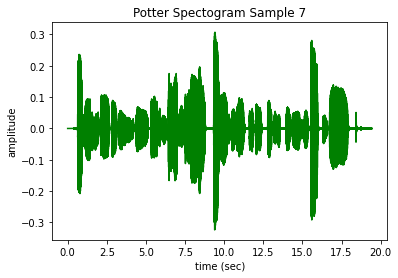

participant           S4
interpretation       Hum
song              Potter
Name: S4_hum_2_Potter.wav, dtype: object



This audio signal has 857627 samples


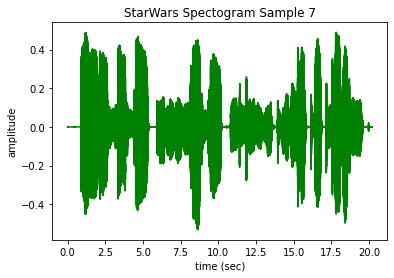

participant             S4
interpretation         Hum
song              StarWars
Name: S4_hum_4_StarWars.wav, dtype: object



This audio signal has 890907 samples


In [ ]:
n=7
fs = None # Sampling frequency. If None, fs would be 22050
x, sr = librosa.load(potterFiles[n],sr=None)
t = np.arange(len(x))/sr
plt.plot(t,x,c='g')
plt.title(f'Potter Spectogram Sample {n}')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
print('\n')
display(MLENDHW_df.iloc[n])
print('\n')
print('This audio signal has', len(x), 'samples')
display(ipd.Audio(potterFiles[n]))


fs = None # Sampling frequency. If None, fs would be 22050
x, sr = librosa.load(starWarsFiles[n],sr=None)
t = np.arange(len(x))/sr
plt.plot(t,x,c='g')
plt.title(f'StarWars Spectogram Sample {n}')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
print('\n')
display(MLENDHW_df.iloc[417+n])
print('\n')
print('This audio signal has', len(x), 'samples')
display(ipd.Audio(starWarsFiles[n]))

If we are using a raw audio signal as the input of a machine learning model, we will be operating in a predictor space consisting of hundreds of thousands of dimensions.

One approach to deal with this huge dimensionality is to extract a few features from our signals and use these features as predictors instead. In this notebook we will use three audio features:

1.   MFCC.
2.   Spectral Bandwith.
3.   Tempo.

In [ ]:
mfcc_list,spec_bw_list,tempo_list=[],[],[]

for i in tqdm(range(len(files))):
  n=i

  y, sr = librosa.load(files[n],sr=None)

  mfcc = librosa.feature.mfcc(y=y, sr=sr)
  mfcc_list.append(np.mean(mfcc))

  spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  spec_bw_list.append(np.mean(spec_bw))

  tempo = librosa.beat.tempo(y, sr=sr)
  tempo_list.append(tempo)

100%|██████████| 834/834 [13:42<00:00,  1.01it/s]


In the next cell we will then create a pandas dataframe with every song name and its features.

In [ ]:
song=MLENDHW_df['song'].tolist()
features_df=pd.DataFrame(song,columns=['Song'])
features_df['MFCC']=mfcc_list
features_df['Spec_Bandwidth']=spec_bw_list
features_df['Tempo']=tempo_list
features_df['Tempo']=features_df['Tempo'].astype(float)
features_df


,Song,MFCC,Spec_Bandwidth,Tempo
0,Potter,-17.621126,5142.033510,172.265625
1,Potter,-21.501249,5266.609683,120.185320
2,Potter,-21.670408,4765.788845,139.674831
3,Potter,-11.944511,1981.262522,123.046875
4,Potter,-26.031940,5767.036432,120.185320
...,...,...,...,...
829,StarWars,-22.566328,1726.818536,107.666016
830,StarWars,-22.310841,2891.146104,101.332721
831,StarWars,-20.766644,3148.085497,99.384014
832,StarWars,-30.624329,4053.917060,126.048018


Let's consider the problem of identifying the song of one of the audio recordings. The next cell defines a function that takes a number of files and creates a NumPy array containing the 3 audio features used as predictors (X) and a binary label (y), that indicates whether the song is Potter (y=1) or StarWars (y=0).

In [ ]:
X,y =[],[]
for Song, MFCC, Spec_Bandwith, Tempo in zip(features_df['Song'], features_df['MFCC'], features_df['Spec_Bandwidth'], features_df['Tempo']):
  yi = Song=='Potter'
  xi = [MFCC,Spec_Bandwith,Tempo]
  X.append(xi)
  y.append(yi)

X=np.array(X)
y=np.array(y)


As the function took approximately 10 minutes to extract the 3 features from all the 834 audio files, we will save our output to .csv files, in order to save time when running the code later for future experiments.

In [ ]:
with open('/content/drive/MyDrive/Data/MLEndHW/X.csv', 'w') as writefile:
    np.savetxt(writefile, X, delimiter=',')
with open('/content/drive/MyDrive/Data/MLEndHW/y.csv', 'w') as writefile:
    np.savetxt(writefile, y, delimiter=',')


The following cell can be used to load X and y we just saved on Google Drive instead to run the feature extraction cell every time.

In [ ]:
from numpy import genfromtxt
X = genfromtxt('/content/drive/MyDrive/Data/MLEndHW/X.csv', delimiter=',')
y = genfromtxt('/content/drive/MyDrive/Data/MLEndHW/y.csv', dtype=np.uint8).astype(bool)

The next cell shows the shape of `X` and `y` and prints the labels vector `y`:

In [ ]:
print('The shape of X is', X.shape)
print('The shape of y is', y.shape)
print('The labels vector is', y)

The shape of X is (834, 3)
The shape of y is (834,)
The labels vector is [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  T

As we can see from the following visualisations, the features appear not to be normally distributed. We will normalise the data using MinMaxScaler.

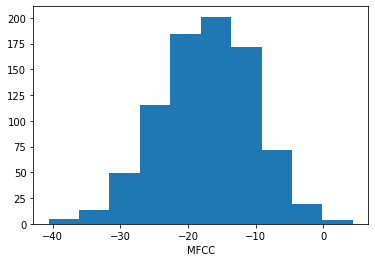

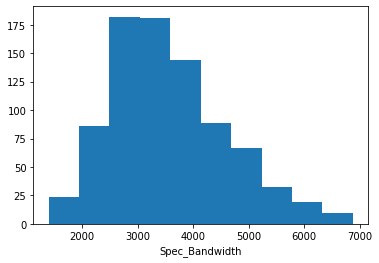

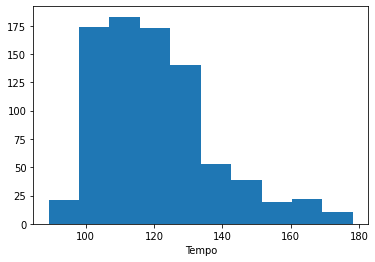

In [ ]:
plt.hist(features_df['MFCC'])
plt.xlabel('MFCC')
plt.show()

plt.hist(features_df['Spec_Bandwidth'])
plt.xlabel('Spec_Bandwidth')
plt.show()

plt.hist(features_df['Tempo'].astype(float))
plt.xlabel('Tempo')
plt.show()

Before scaling the features (X) we will split the dataset into training and validation subsets, then we will fit the scaler on the training set and apply the transform function of both sets to create a normalised version of them. This avoids data leakage as the calculation of the minimum and maximum value for each input variable is calculated using only the training dataset (X_train) instead of the entire dataset (X).'stratify' parameter is set in order to keep the same balance between classes after the splitting.

In [ ]:
scaler = MinMaxScaler()
X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.3, stratify=y)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_val = scaler.transform(X_val)



# 8 Results

**Support Vector Machine model**

Let's build a support vector machine (SVM) model for the predictive task of identifying the song (Potter/StarWars) of an audio signal, using the dataset that we have just created and the SVM method provided by scikit-learn.


In [ ]:
SVM  = svm.SVC(C=1)
SVM.fit(X_train,y_train)

SVMTrainPrediction = SVM.predict(X_train)
SVMValidationPrediction = SVM.predict(X_val)

print('SVM results:')
print('\nTraining Accuracy', np.mean(SVMTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(SVMValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=SVM.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, SVM.predict(X_val)))

SVM results:

Training Accuracy 0.7735849056603774
Validation  Accuracy 0.7609561752988048
MCC Score 0.5392812923387327
Kappa Score 0.5214185839583069


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=SVM.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=SVM.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[197  95]
 [ 37 254]]

Validation confusion matrix:
 [[ 79  46]
 [ 14 112]]

Normalised training confusion matrix:
 [[0.67465753 0.32534247]
 [0.12714777 0.87285223]]

Normalised validation confusion matrix:
 [[0.632      0.368     ]
 [0.11111111 0.88888889]]



**Logistic Regression model**

Let's build a Logistic Regression model for the predictive task of identifying the song (Potter/StarWars) of an audio signal, using the dataset that we have just created and the LogisticRegression method provided by scikit-learn.

In [ ]:
LR = LogisticRegression()
LR.fit(X_train, y_train)

LRTrainPrediction = LR.predict(X_train)
LRValidationPrediction = LR.predict(X_val)

print('Logistic Regression results:')
print('\nTraining Accuracy', np.mean(LRTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(LRValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=LR.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, LR.predict(X_val)))

Logistic Regression results:

Training Accuracy 0.7324185248713551
Validation  Accuracy 0.7171314741035857
MCC Score 0.4346887789606888
Kappa Score 0.43434375495953026


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=LR.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=LR.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[222  70]
 [ 86 205]]

Validation confusion matrix:
 [[92 33]
 [38 88]]

Normalised training confusion matrix:
 [[0.76027397 0.23972603]
 [0.29553265 0.70446735]]

Normalised validation confusion matrix:
 [[0.736     0.264    ]
 [0.3015873 0.6984127]]



**Naive Bayes model**

Let's build a Gaussian Naive Bayes model for the predictive task of identifying the song (Potter/StarWars) of an audio signal, using the dataset that we have just created and the GaussianNB method provided by scikit-learn.

In [ ]:
gNB = GaussianNB()
gNB.fit(X_train, y_train)

gNBTrainPrediction = gNB.predict(X_train)
gNBValidationPrediction = gNB.predict(X_val)

print('Naive Bayes results:')
print('\nTraining Accuracy', np.mean(gNBTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(gNBValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=gNB.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, gNB.predict(X_val)))

Naive Bayes results:

Training Accuracy 0.7169811320754716
Validation  Accuracy 0.7051792828685259
MCC Score 0.4131878954386019
Kappa Score 0.41061115694611916


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=gNB.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=gNB.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[229  63]
 [102 189]]

Validation confusion matrix:
 [[95 30]
 [44 82]]

Normalised training confusion matrix:
 [[0.78424658 0.21575342]
 [0.35051546 0.64948454]]

Normalised validation confusion matrix:
 [[0.76       0.24      ]
 [0.34920635 0.65079365]]



**XGBoost Classifier**

Let's build a XGBoost Classifier model for the predictive task of identifying the song (Potter/StarWars) of an audio signal, using the dataset that we have just created and the XGBClassifier method provided by xgboost.

In [ ]:
XGB = XGBClassifier(n_estimators=30, max_depth=3, objective='binary:logistic')
XGB.fit(X_train, y_train)

XGBTrainPrediction = XGB.predict(X_train)
XGBValidationPrediction = XGB.predict(X_val)

print('XGBoost results:')
print('\nTraining Accuracy', np.mean(XGBTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(XGBValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=XGB.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, XGB.predict(X_val)))

XGBoost results:

Training Accuracy 0.7804459691252144
Validation  Accuracy 0.7410358565737052
MCC Score 0.522895643888816
Kappa Score 0.4812565578201011


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=XGB.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=XGB.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[178 114]
 [ 14 277]]

Validation confusion matrix:
 [[ 68  57]
 [  8 118]]

Normalised training confusion matrix:
 [[0.60958904 0.39041096]
 [0.04810997 0.95189003]]

Normalised validation confusion matrix:
 [[0.544      0.456     ]
 [0.06349206 0.93650794]]



**AdaBoost Classifier**

Let's build a AdaBoost Classifier model for the predictive task of identifying the song (Potter/StarWars) of an audio signal, using the dataset that we have just created and the AdaBoostClassifier method provided by sklearn.

In [ ]:
adaBoost = AdaBoostClassifier(n_estimators=10)
adaBoost.fit(X_train, y_train)

adaBoostTrainPrediction = adaBoost.predict(X_train)
adaBoostValidationPrediction = adaBoost.predict(X_val)

print('Training Accuracy', np.mean(adaBoostTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(adaBoostValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=adaBoost.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, adaBoost.predict(X_val)))

Training Accuracy 0.7667238421955404
Validation  Accuracy 0.7370517928286853
MCC Score 0.49954839493016284
Kappa Score 0.47342657342657346


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=adaBoost.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=adaBoost.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[186 106]
 [ 30 261]]

Validation confusion matrix:
 [[ 72  53]
 [ 13 113]]

Normalised training confusion matrix:
 [[0.6369863  0.3630137 ]
 [0.10309278 0.89690722]]

Normalised validation confusion matrix:
 [[0.576     0.424    ]
 [0.1031746 0.8968254]]



# 9 Conclusions

In [ ]:
print('Model evaluation summary:')

print('\nValidation accuracy:')
print('SVM:', np.mean(SVMValidationPrediction==y_val))
print('Logistic Regression:', np.mean(LRValidationPrediction==y_val))
print('Naive Bayes:', np.mean(gNBValidationPrediction==y_val))
print('XGBoost:', np.mean(XGBValidationPrediction==y_val))
print('AdaBoost:', np.mean(adaBoostValidationPrediction==y_val))

print('\n--------------------------------------------------------')

print('\nMatthews correlation coefficient:')
print('SVM: '+ str(matthews_corrcoef(y_true=y_val, y_pred=SVM.predict(X_val))))
print('Logistic Regression: '+ str(matthews_corrcoef(y_true=y_val, y_pred=LR.predict(X_val))))
print('Naive Bayes: '+ str(matthews_corrcoef(y_true=y_val, y_pred=gNB.predict(X_val))))
print('XGBoost: '+ str(matthews_corrcoef(y_true=y_val, y_pred=XGB.predict(X_val))))
print('Adaboost: '+ str(matthews_corrcoef(y_true=y_val, y_pred=adaBoost.predict(X_val))))

print('\n--------------------------------------------------------')

print('\nKappa Score:')
print('SVM: '+ str(cohen_kappa_score(y_val, SVM.predict(X_val))))
print('Logistic Regression: '+ str(cohen_kappa_score(y_val, LR.predict(X_val))))
print('Naive Bayes: '+ str(cohen_kappa_score(y_val, gNB.predict(X_val))))
print('XGBoost: '+ str(cohen_kappa_score(y_val, XGB.predict(X_val))))
print('Adaboost: '+ str(cohen_kappa_score(y_val, adaBoost.predict(X_val))))

Model evaluation summary:

Validation accuracy:
SVM: 0.7609561752988048
Logistic Regression: 0.7171314741035857
Naive Bayes: 0.7051792828685259
XGBoost: 0.7410358565737052
AdaBoost: 0.7370517928286853

--------------------------------------------------------

Matthews correlation coefficient:
SVM: 0.5392812923387327
Logistic Regression: 0.4346887789606888
Naive Bayes: 0.4131878954386019
XGBoost: 0.522895643888816
Adaboost: 0.49954839493016284

--------------------------------------------------------

Kappa Score:
SVM: 0.5214185839583069
Logistic Regression: 0.43434375495953026
Naive Bayes: 0.41061115694611916
XGBoost: 0.4812565578201011
Adaboost: 0.47342657342657346


As shown in the evaluation report, all the machine learning models trained for this experiment are giving similar results; although SVM has the best score in all the metrics evaluated having the highest accuracy on validation data, the highest Matthews correlation coefficient and the highest Kappa score.
In order to improve these results different audio features can be extracted and tested in future experiments; classes can be furtherly balanced: even if the amount of Potter and StarWars samples is balanced, the dataset consists of 598 hums 236 whistles.